# Análisis Exploratorio de Datos

En este notebook se realiza un análisis exploratorio de los datos del dataset de segmentación de vocales. Se analizan las distribuciones de las variables, se identifican valores atípicos y se estudia la correlación entre las variables. El objetivo es obtener una mejor comprensión de los datos y de las relaciones entre las variables.

In [2]:
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

Cargamos el dataset y mostramos las primeras filas para entender la estructura de los datos.

In [3]:
dataset_name = "vowel_features_20250210_010818"
dataset_path = Path(
    f"../../data/processed/datasets/vowel_features/{dataset_name}.csv"
)
df = pd.read_csv(dataset_path)

In [4]:
df.head()

,file,label,f0_mean,f1_mean,f2_mean,f3_mean,intensity_mean,jitter_local,shimmer_local,f0_median,...,health-voicevow-m,health-voicevow-all,trust-voicesent-f,trust-voicesent-m,trust-voicesent-all,trust-voicevow-f,trust-voicevow-m,trust-voicevow-all,age,sex
0,M-300_VoiceVowel.wav,M-300,122.322069,635.195806,1767.373862,3043.066290,58.393201,0.030243,0.089393,108.702278,...,"65,4","71,2","61,7","43,5","52,2","78,9","58,8","68,4",21.0,Male
1,M-337_VoiceVowel.wav,M-337,128.490284,609.408444,1657.802047,2873.230920,54.146626,0.022896,0.126083,112.885902,...,"77,0","75,9","45,0","47,6","46,3","59,5","66,1","62,8",20.0,Male
2,F-163_VoiceVowel.wav,F-163,244.779671,778.045595,1912.752299,3162.830370,57.474203,0.011711,0.105925,243.676692,...,"72,1","68,5","51,8","45,9","48,9","57,2","61,6","59,4",21.0,Female
3,F-329_VoiceVowel.wav,F-329,248.108167,647.491493,1760.853414,2908.456272,55.920847,0.021368,0.090407,243.117655,...,"58,7","60,0","43,9","41,7","42,7","52,9","51,3","52,0",21.0,Female
4,F-154_VoiceVowel.wav,F-154,244.347591,628.516425,1663.641613,3071.155453,52.288688,0.025479,0.133791,241.240378,...,"50,7","55,3","64,9","61,2","63,1","57,9","62,2","60,0",18.0,Female


### Exploración de las columnas del dataset

El dataset {{dataset_name}} contiene las siguientes columnas:

- file: Nombre del archivo de audio.
- label: Etiqueta de la muestra.
- mean_pitch, mean_f1, mean_f2, mean_f3: Características acústicas relacionadas con el tono y los formantes.
- mean_intensity: Intensidad promedio de la muestra de voz.
- local_jitter, local_shimmer: Medidas de perturbaciones en la señal de voz.
- health-voicevow-m
- health-voicevow-f,
- health-voicevow-all
- trust-voicevow-m
- trust-voicevow-f
- trust-voicevow-all, 
- attrac-voicevow-m, 
- attrac-voicevow-f, 
- attrac-voicevow-all, 
- mascfem-voicevow-m, 
- mascfem-voicevow-f, 
- mascfem-voicevow-all, 
- domin-voicevow-m, 
- domin-voicevow-f, 
- domin-voicevow-all: Puntuaciones perceptuales relacionadas con la salud y la confianza.
- age: Edad del hablante.
- sex: Género del hablante.

Podemos observar que las variables que provienen del datased de GEVAF entran en 2 grupos, segun si hacen referencia a la pronunciacion de vocales o a la pronunciacion de sentencias.

Las variables que hacen referencia a la pronunciacion de vocales son:
- health-voicevow-m
- health-voicevow-f
- health-voicevow-all
- trust-voicevow-m
- trust-voicevow-f
- trust-voicevow-all, 
- attrac-voicevow-m,    
- attrac-voicevow-f, 
- attrac-voicevow-all, 
- mascfem-voicevow-m, 
- mascfem-voicevow-f, 
- mascfem-voicevow-all, 
- domin-voicevow-m, 
- domin-voicevow-f, 
- domin-voicevow-all, 

Las variables que hacen referencia a la pronunciacion de sentencias son:
- health-voicesent-f
- health-voicesent-m
- health-voicesent-all
- trust-voicesent-f
- trust-voicesent-m
- trust-voicesent-all
- attrac-voicesent-f
- attrac-voicesent-m
- attrac-voicesent-all  
- mascfem-voicesent-f
- mascfem-voicesent-m
- mascfem-voicesent-all
- domin-voicesent-f
- domin-voicesent-m
- domin-voicesent-all.

Luego podemos hacer una diferenciacion entre voces masculinas y femeninas.

Ahora bien, que significan estas variables segun el dataset de GEVAF?

- health-voicevow-m: Salud de la voz masculina.
- health-voicevow-f: Salud de la voz femenina.
- health-voicevow-all: Salud de la voz masculina y femenina.

- trust-voicevow-m: Confianza de la voz masculina.
- trust-voicevow-f: Confianza de la voz femenina.
- trust-voicevow-all: Confianza de la voz masculina y femenina.

- attrac-voicevow-m: Atractivo de la voz masculina.
- attrac-voicevow-f: Atractivo de la voz femenina.
- attrac-voicevow-all: Atractivo de la voz masculina y femenina.

- mascfem-voicevow-m: Masculinidad de la voz masculina.
- mascfem-voicevow-f: Masculinidad de la voz femenina.
- mascfem-voicevow-all: Masculinidad de la voz masculina y femenina.

- domin-voicevow-m: Dominancia de la voz masculina.
- domin-voicevow-f: Dominancia de la voz femenina.
- domin-voicevow-all: Dominancia de la voz masculina y femenina.

Estas variables son el resultado de un proceso de evaluacion realizado por los autores de GEVAF. Consiste en una evaluacion subjetiva de la voz, en la que se le pide a un grupo de hablantes masculinos y femeninos que evalúen la voz de un grupo de hablantes masculinos y femeninos. El proeso de evaluacion se realizo dos etapas. En el primero se evaluo un subset de los stimulos vocales y en el segundo se evaluo la totalidad de los stimulos vocales. Los participantes evaluadores de stimulos, en total 285, fueron jovenes europeos entre 18 y 35 años. A cada participante se le presentaron 111 estímulos vocales, 50 masculinos y 61 femeninos. En lo que respecta a estimulos vocales, esta compuesto de dos tipos de estímulos: Una secuencia de vocales y una frase en frances.

Las calificaciones en el conjunto de datos GEFAV se recopilaron utilizando una escala de 0-100, las cuales fueron promediadas para obtener un valor final.


La variable age se encuentra en años y la variable sex se encuentra en binario, Male (M) o Female (F).
La variable file se refiere al nombre del archivo de audio.
La variable label se refiere a la etiqueta de la muestra.
La variable mean_pitch se refiere al tono promedio de la muestra de voz.
La variable mean_f1 se refiere al primer formante promedio de la muestra de voz.
La variable mean_f2 se refiere al segundo formante promedio de la muestra de voz.
La variable mean_f3 se refiere al tercer formante promedio de la muestra de voz.
La variable mean_intensity se refiere a la intensidad promedio de la muestra de voz.
La variable local_jitter se refiere a la variabilidad en el período de las vibraciones de las cuerdas vocales.
La variable local_shimmer se refiere a la variabilidad en la amplitud de las vibraciones de las cuerdas vocales.

La variable health-voicevow-m se refiere a la salud percibida de la voz masculina. Es el promedio de las puntuaciones de salud de la voz de hombres puntuadas por los evaluadores de ambos generos.
La variable health-voicevow-f se refiere a la salud percibida de la voz femenina. Es el promedio de las puntuaciones de salud de la voz de mujeres puntuadas por los evaluadores de ambos generos.
La variable health-voicevow-all se refiere a la salud percibida de la voz masculina y femenina. Es el promedio de las puntuaciones de salud de la voz de hombres y mujeres puntuadas por los evaluadores de ambos generos.

La variable trust-voicevow-m se refiere a la confianza percibida de la voz masculina. Es el promedio de las puntuaciones de confianza de la voz de hombres puntuadas por los evaluadores de ambos generos.
La variable trust-voicevow-f se refiere a la confianza percibida de la voz femenina. Es el promedio de las puntuaciones de confianza de la voz de mujeres puntuadas por los evaluadores de ambos generos.
La variable trust-voicevow-all se refiere a la confianza percibida de la voz masculina y femenina. Es el promedio de las puntuaciones de confianza de la voz de hombres y mujeres puntuadas por los evaluadores de ambos generos.

La variable attrac-voicevow-m se refiere a la atraccion percibida de la voz masculina. Es el promedio de las puntuaciones de atraccion de la voz de hombres puntuadas por los evaluadores de ambos generos.
La variable attrac-voicevow-f se refiere a la atraccion percibida de la voz femenina. Es el promedio de las puntuaciones de atraccion de la voz de mujeres puntuadas por los evaluadores de ambos generos.
La variable attrac-voicevow-all se refiere a la atraccion percibida de la voz masculina y femenina. Es el promedio de las puntuaciones de atraccion de la voz de hombres y mujeres puntuadas por los evaluadores de ambos generos.

La variable mascfem-voicevow-m se refiere a la masculinidad percibida de la voz masculina. Es el promedio de las puntuaciones de masculinidad de la voz de hombres puntuadas por los evaluadores de ambos generos.
La variable mascfem-voicevow-f se refiere a la masculinidad percibida de la voz femenina. Es el promedio de las puntuaciones de masculinidad de la voz de mujeres puntuadas por los evaluadores de ambos generos.
La variable mascfem-voicevow-all se refiere a la masculinidad percibida de la voz masculina y femenina. Es el promedio de las puntuaciones de masculinidad de la voz de hombres y mujeres puntuadas por los evaluadores de ambos generos.

La variable domin-voicevow-m se refiere a la dominancia percibida de la voz masculina. Es el promedio de las puntuaciones de dominancia de la voz de hombres puntuadas por los evaluadores de ambos generos.  
La variable domin-voicevow-f se refiere a la dominancia percibida de la voz femenina. Es el promedio de las puntuaciones de dominancia de la voz de mujeres puntuadas por los evaluadores de ambos generos.
La variable domin-voicevow-all se refiere a la dominancia percibida de la voz masculina y femenina. Es el promedio de las puntuaciones de dominancia de la voz de hombres y mujeres puntuadas por los evaluadores de ambos generos.










### Información de los tipos de datos y valores nulos en el dataset

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 111 entries, 0 to 110
Data columns (total 44 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   file                   111 non-null    object 
 1   label                  111 non-null    object 
 2   f0_mean                111 non-null    float64
 3   f1_mean                111 non-null    float64
 4   f2_mean                111 non-null    float64
 5   f3_mean                111 non-null    float64
 6   intensity_mean         111 non-null    float64
 7   jitter_local           111 non-null    float64
 8   shimmer_local          111 non-null    float64
 9   f0_median              111 non-null    float64
 10  f0_std                 111 non-null    float64
 11  sample_name            111 non-null    object 
 12  attrac-voicesent-f     108 non-null    object 
 13  attrac-voicesent-m     108 non-null    object 
 14  attrac-voicesent-all   108 non-null    object 
 15  attrac

El dataset contiene 111 observaciones y 42 columnas que representan las variables. El resumen muestra que la mayoria de las columnas son de tipo categorico (object), lo cual no es cierto ya que la mayoria de esas columnas son numericas. Vamos a convertir esas columnas a numericas en el siguiente paso. El resto de las columnas son de tipo numerico (float64).

En resumen, hay 8 columnas de tipo numerico float64 y 34 columnas de tipo object, sumando un total de 42 columnas.

En lo que respecta a la completitud de los datos, hay varias columnas que tienen valores nulos.

- attrac-voicesent-f (108 valores no nulos)
- attrac-voicesent-m (108 valores no nulos)
- attrac-voicesent-all (108 valores no nulos)
- mascfem-voicesent-f (108 valores no nulos)
- mascfem-voicesent-m (108 valores no nulos)
- mascfem-voicesent-all (108 valores no nulos)
- domin-voicesent-f (108 valores no nulos)
- domin-voicesent-m (108 valores no nulos)
- domin-voicesent-all (108 valores no nulos)
- health-voicesent-f (108 valores no nulos)
- health-voicesent-m (108 valores no nulos)
- health-voicesent-all (108 valores no nulos)
- trust-voicesent-f (108 valores no nulos)
- trust-voicesent-m (108 valores no nulos)
- trust-voicesent-all (108 valores no nulos)

En resumen:
1. El dataset es relativamente chico, con 111 observaciones y 42 columnas, ocupando en memoria 36.5 KB de memoria.
2. En los proximos pasos se analizaran los valores nulos y se realizaran las correcciones necesarias.
3. Es necesario tambien convertir las columnas que son numericas pero estan siendo tratadas como categoricas.


In [7]:
columns_to_convert = [
    "attrac-voicesent-f",
    "attrac-voicesent-m",
    "attrac-voicesent-all",
    "attrac-voicevow-f",
    "attrac-voicevow-m",
    "attrac-voicevow-all",
    "mascfem-voicesent-f",
    "mascfem-voicesent-m",
    "mascfem-voicesent-all",
    "mascfem-voicevow-f",
    "mascfem-voicevow-m",
    "mascfem-voicevow-all",
    "domin-voicesent-f",
    "domin-voicesent-m",
    "domin-voicesent-all",
    "domin-voicevow-f",
    "domin-voicevow-m",
    "domin-voicevow-all",
    "health-voicesent-f",
    "health-voicesent-m",
    "health-voicesent-all",
    "health-voicevow-f",
    "health-voicevow-m",
    "health-voicevow-all",
    "trust-voicesent-f",
    "trust-voicesent-m",
    "trust-voicesent-all",
    "trust-voicevow-f",
    "trust-voicevow-m",
    "trust-voicevow-all",
]

for column in columns_to_convert:
    df[column] = df[column].str.replace(",", ".").astype(float)

df["age"] = df["age"].astype(int)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 111 entries, 0 to 110
Data columns (total 44 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   file                   111 non-null    object 
 1   label                  111 non-null    object 
 2   f0_mean                111 non-null    float64
 3   f1_mean                111 non-null    float64
 4   f2_mean                111 non-null    float64
 5   f3_mean                111 non-null    float64
 6   intensity_mean         111 non-null    float64
 7   jitter_local           111 non-null    float64
 8   shimmer_local          111 non-null    float64
 9   f0_median              111 non-null    float64
 10  f0_std                 111 non-null    float64
 11  sample_name            111 non-null    object 
 12  attrac-voicesent-f     108 non-null    float64
 13  attrac-voicesent-m     108 non-null    float64
 14  attrac-voicesent-all   108 non-null    float64
 15  attrac

Se puede validar que las columnas que eran numericas pero estaban siendo tratadas como categoricas han sido convertidas a numericas. Ahora vamos a analizar los valores nulos en el dataset y a realizar las correcciones necesarias.

In [8]:
df.isnull().sum()

file                     0
label                    0
f0_mean                  0
f1_mean                  0
f2_mean                  0
f3_mean                  0
intensity_mean           0
jitter_local             0
shimmer_local            0
f0_median                0
f0_std                   0
sample_name              0
attrac-voicesent-f       3
attrac-voicesent-m       3
attrac-voicesent-all     3
attrac-voicevow-f        0
attrac-voicevow-m        0
attrac-voicevow-all      0
mascfem-voicesent-f      3
mascfem-voicesent-m      3
mascfem-voicesent-all    3
mascfem-voicevow-f       0
mascfem-voicevow-m       0
mascfem-voicevow-all     0
domin-voicesent-f        3
domin-voicesent-m        3
domin-voicesent-all      3
domin-voicevow-f         0
domin-voicevow-m         0
domin-voicevow-all       0
health-voicesent-f       3
health-voicesent-m       3
health-voicesent-all     3
health-voicevow-f        0
health-voicevow-m        0
health-voicevow-all      0
trust-voicesent-f        3
t

Se observa que hay valores nulos en las siguientes columnas:
- attrac-voicesent-f (3 valores nulos)
- attrac-voicesent-m (3 valores nulos)
- attrac-voicesent-all (3 valores nulos)
- mascfem-voicesent-f (3 valores nulos)
- mascfem-voicesent-m (3 valores nulos)
- mascfem-voicesent-all (3 valores nulos)
- domin-voicesent-f (3 valores nulos)
- domin-voicesent-m (3 valores nulos)
- domin-voicesent-all (3 valores nulos)
- health-voicesent-f (3 valores nulos)
- health-voicesent-m (3 valores nulos)
- health-voicesent-all (3 valores nulos)
- trust-voicesent-f (3 valores nulos)
- trust-voicesent-m (3 valores nulos)
- trust-voicesent-all (3 valores nulos)

El total de observaciones es 111, por lo que eliminar 3 observaciones representa una pérdida de información del 2.7%. Por lo tanto, se procederá a eliminar las observaciones con valores nulos en las columnas mencionadas.

In [9]:
df_cleaned = df.dropna()

Luego de elimnar los valores nulos, se procede a guardar el dataset limpio en un archivo CSV.

In [10]:
df_cleaned.to_csv(dataset_path.parent / "no_nulls_dataset.csv", index=False)

In [11]:
df = df_cleaned
df.head()

,file,label,f0_mean,f1_mean,f2_mean,f3_mean,intensity_mean,jitter_local,shimmer_local,f0_median,...,health-voicevow-m,health-voicevow-all,trust-voicesent-f,trust-voicesent-m,trust-voicesent-all,trust-voicevow-f,trust-voicevow-m,trust-voicevow-all,age,sex
0,M-300_VoiceVowel.wav,M-300,122.322069,635.195806,1767.373862,3043.066290,58.393201,0.030243,0.089393,108.702278,...,65.4,71.2,61.7,43.5,52.2,78.9,58.8,68.4,21,Male
1,M-337_VoiceVowel.wav,M-337,128.490284,609.408444,1657.802047,2873.230920,54.146626,0.022896,0.126083,112.885902,...,77.0,75.9,45.0,47.6,46.3,59.5,66.1,62.8,20,Male
2,F-163_VoiceVowel.wav,F-163,244.779671,778.045595,1912.752299,3162.830370,57.474203,0.011711,0.105925,243.676692,...,72.1,68.5,51.8,45.9,48.9,57.2,61.6,59.4,21,Female
3,F-329_VoiceVowel.wav,F-329,248.108167,647.491493,1760.853414,2908.456272,55.920847,0.021368,0.090407,243.117655,...,58.7,60.0,43.9,41.7,42.7,52.9,51.3,52.0,21,Female
4,F-154_VoiceVowel.wav,F-154,244.347591,628.516425,1663.641613,3071.155453,52.288688,0.025479,0.133791,241.240378,...,50.7,55.3,64.9,61.2,63.1,57.9,62.2,60.0,18,Female


### Estadísticas Descriptivas del Dataset
A continuación se muestran las estadísticas descriptivas del dataset.

In [12]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
f0_mean,108.0,199.519536,55.904642,107.950996,148.215670,215.001326,245.595720,300.565688
f1_mean,108.0,706.179345,83.056773,478.346263,646.600239,714.350405,768.508676,914.571622
f2_mean,108.0,1770.196128,92.461319,1561.547987,1701.770468,1769.873737,1831.378216,2083.278337
f3_mean,108.0,3001.082318,108.927446,2740.656174,2924.200378,2999.419115,3072.404591,3354.167720
intensity_mean,108.0,56.190307,2.420501,48.427900,54.971663,56.058846,57.426489,62.839628
jitter_local,108.0,0.022387,0.007490,0.004604,0.017738,0.021032,0.026196,0.045048
shimmer_local,108.0,0.096729,0.028614,0.045709,0.075476,0.090062,0.115004,0.209081
f0_median,108.0,187.616890,56.055537,99.392545,128.034447,204.423059,237.348107,280.913753
f0_std,108.0,43.680302,31.352693,3.497790,18.679089,39.465978,59.873099,167.951543
attrac-voicesent-f,108.0,51.375926,12.578248,20.200000,43.950000,51.100000,60.200000,75.800000


#### Funciones para el Análisis Exploratorio de Datos

In [13]:
def plot_boxplot(df, feature, ax, color=None):
    # import seaborn as sns

    if color:
        sns.boxplot(x=color, y=feature, hue=color, data=df, palette="Set1")
        ax.legend(title=color)
    else:
        sns.boxplot(y=feature, data=df)


def plot_all_single_boxplot(df, feature, label_name, title, aggregated_label, color=None, bins=30, caption=None):
    fig = plt.figure(figsize=(20, 15))

    ax1 = plt.subplot(1, 1, 1)
    plot_boxplot(df, feature, ax1, color=color)

    plt.title(title, fontsize=25)
    plt.ylabel(label_name, fontsize=18)
    plt.xlabel("Genero", fontsize=18)

    plt.xticks(fontsize=18)
    plt.yticks(fontsize=18)

    plt.tight_layout()

    plt.figtext(0.5, -0.1, caption, ha="center", fontsize=20)
    plt.show()

### Analisis de las variables caracteristicas de la voz

#### Mean Pitch

In [14]:
# Change the values of columns 'sex' to 'Masculino' and 'Femenino'
df_cleaned['sex'] = df_cleaned['sex'].replace({'Male': 'Masculino', 'Female': 'Femenino'})

/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/3616664066.py:6: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(title=color)


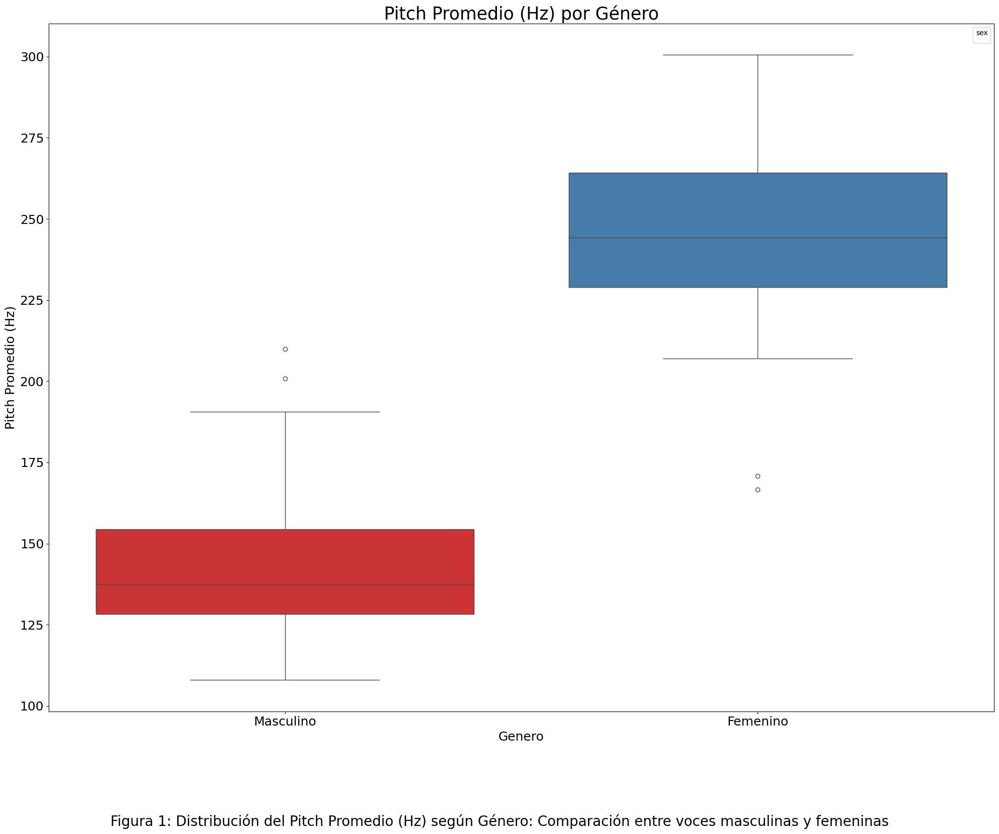

In [15]:
plot_all_single_boxplot(df=df_cleaned, feature="f0_mean", label_name="Pitch Promedio (Hz)", title="Pitch Promedio (Hz) por Género", aggregated_label="Género", color="sex", bins=30, caption="Figura 1: Distribución del Pitch Promedio (Hz) según Género: Comparación entre voces masculinas y femeninas")

#### Mean F1, Mean F2, Mean F3

In [16]:
def plot_boxplot_by_group(df, features, group_by, axes):
    for i, feature in enumerate(features):
        sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
        # axes[i].set_title(f"Distribución de {feature}", fontsize=20, wrap=True)
        axes[i].set_ylabel(feature, fontsize=18, labelpad=30, wrap=True)  # Increased padding for y-axis labels
        axes[i].set_xlabel("Genero", fontsize=18)
        axes[i].tick_params(axis='y', labelsize=18)  # Ensure y-axis tick labels are visible
        axes[i].tick_params(axis='x', labelsize=18)  # Ensure x-axis tick labels are visible
def plot_all_boxplots_by_group(df, features, group_by, title, caption):
    fig, axes = plt.subplots(1, len(features), figsize=(25, 10), sharey=False)  # Disable shared y-axis
    
    # Plot each boxplot
    plot_boxplot_by_group(df, features, group_by, axes)
    
    # Add caption and title
    plt.figtext(0.5, -0.1, caption, ha="center", fontsize=20, wrap=True)
    fig.suptitle(title, fontsize=25)
    
    # Adjust layout to prevent overlap and increase spacing
    plt.tight_layout(rect=[0.01, 0.2, 1.0, 0.9])  # Leave more space for title and caption
    plt.subplots_adjust(wspace=0.4)  # Increase horizontal spacing between subplots
    
    plt.show()

/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i],

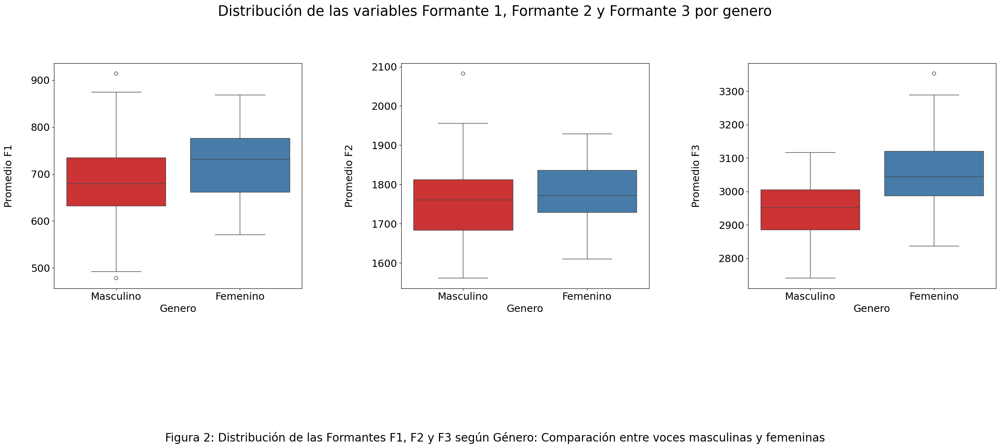

In [17]:
# Create a sample DataFrame for demonstration
data = {
    'Promedio F1': df_cleaned['f1_mean'],
    'Promedio F2': df_cleaned['f2_mean'],
    'Promedio F3': df_cleaned['f3_mean'],
    'sex': df_cleaned['sex']
}
df = pd.DataFrame(data)

# Features to plot
features = ['Promedio F1', 'Promedio F2', 'Promedio F3']

# Plot the boxplots grouped by 'sex'
plot_all_boxplots_by_group(df=df, features=features, group_by='sex', title="Distribución de las variables Formante 1, Formante 2 y Formante 3 por genero", caption="Figura 2: Distribución de las Formantes F1, F2 y F3 según Género: Comparación entre voces masculinas y femeninas")


#### Mean Intensity

/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/3616664066.py:6: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(title=color)


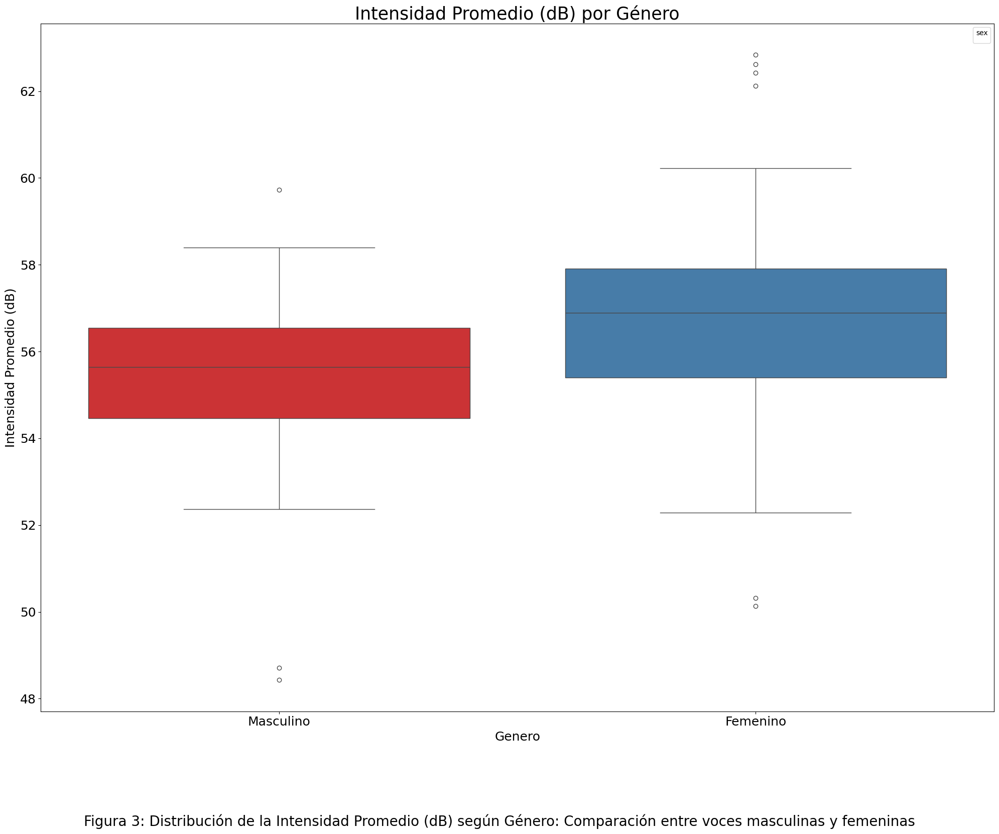

In [19]:
plot_all_single_boxplot(
    df_cleaned,
    "intensity_mean",
    label_name="Intensidad Promedio (dB)",
    title="Intensidad Promedio (dB) por Género",
    aggregated_label="Género",
    color="sex",
    bins=30,
    caption="Figura 3: Distribución de la Intensidad Promedio (dB) según Género: Comparación entre voces masculinas y femeninas"

)

El grafico muestra que los hablantes masculinos (en azul) y femeninos (en rojo) tienen distribuciones de intensidad superpuestas, aunque hay algunas diferencias notables en los picos y rangos. Los valores de intensidad para los hombres están más concentrados en los rangos de 52 dB a 58 dB. Las mujeres muestran una distribución más dispersa, con picos en los rangos de 53 dB a 58 dB, y algunos valores más altos en comparación con los hombres.

Hay una superposición considerable en el rango de 54 dB a 58 dB, pero fuera de este rango, los valores de intensidad de hombres y mujeres tienden a separarse más.

#### Local Jitter

El "jitter (local)" mide la variabilidad en el período de las vibraciones de las cuerdas vocales. Específicamente, es la diferencia absoluta promedio entre períodos consecutivos, dividida por el período promedio. Este parámetro es utilizado para evaluar la estabilidad de la frecuencia de la voz, una voz con buena estabilidad temporal suena más natural y agradable. Las irregularidades en el periodo de la onda sonora pueden hacer que la voz suene temblorosa o inestable, afectando la percepción de la calidad vocal.

 La medida se expresa como un porcentaje.

/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/3616664066.py:6: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(title=color)


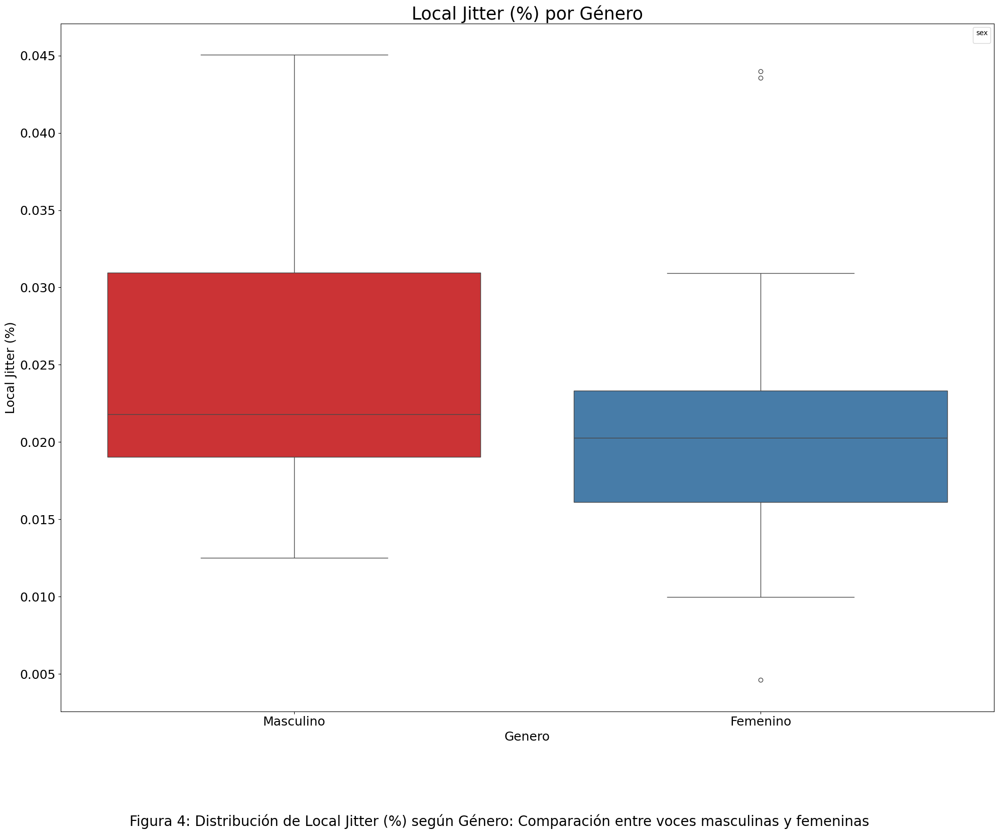

In [20]:
plot_all_single_boxplot(
    df_cleaned,
    "jitter_local",
    label_name="Local Jitter (%)",
    title="Local Jitter (%) por Género",
    aggregated_label="Género",
    color="sex",
    bins=30,
    caption="Figura 4: Distribución de Local Jitter (%) según Género: Comparación entre voces masculinas y femeninas"
)

### Local shimmer

/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/3616664066.py:6: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(title=color)


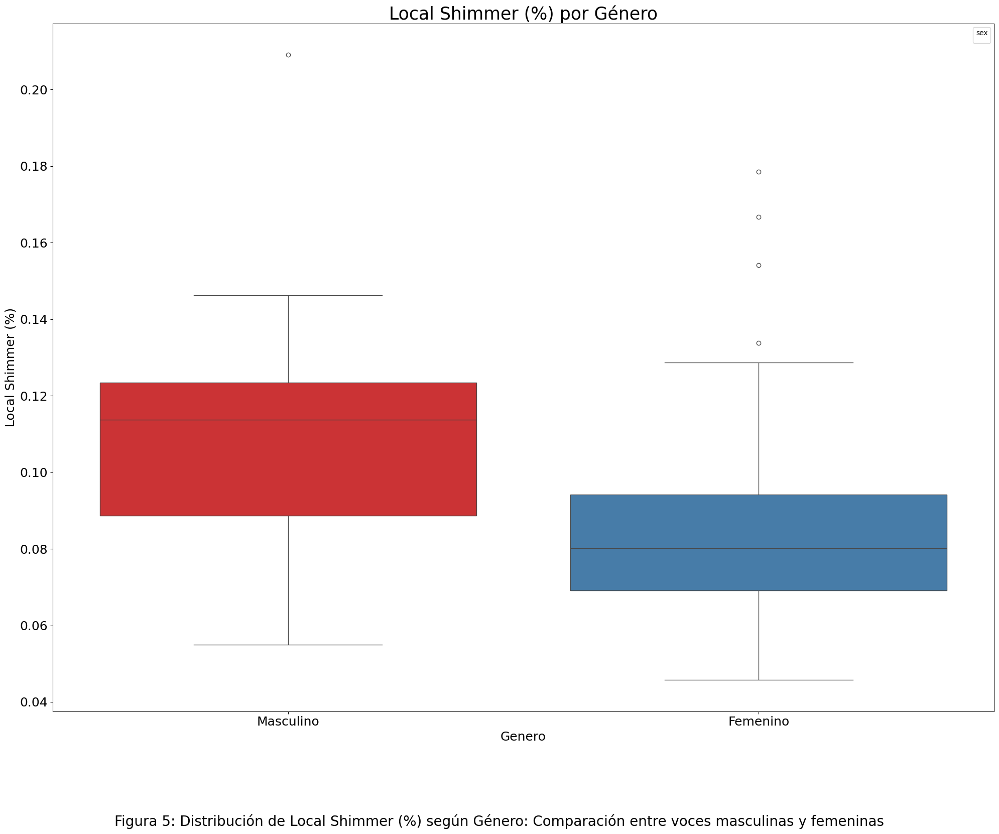

In [21]:
plot_all_single_boxplot(
    df_cleaned,
    "shimmer_local",
    label_name="Local Shimmer (%)",
    title="Local Shimmer (%) por Género",
    aggregated_label="Género",
    color="sex",
    bins=30,
    caption="Figura 5: Distribución de Local Shimmer (%) según Género: Comparación entre voces masculinas y femeninas"
)

### Attractiveness

ATTRAC	attractiveness (0=not at all attractive / 100=extremely attractive)

La variable ATTRACTIVE en el dataset GEFAV representa la atractividad de la voz. Es una variable continua que se mide en una escala de 0 a 100, donde:
0: Indica que la voz no es atractiva en absoluto.
100: Indica que la voz es extremadamente atractiva.

#### Attractiveness - Percepcion segun evaluadores masculinos.

In [22]:
def plot_boxplot_by_group_attractiveness(df, features, group_by, axes):
    for i, feature in enumerate(features):
        sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
        # axes[i].set_title(f"Distribución de {feature}", fontsize=20, wrap=True)
        axes[i].set_ylabel(feature, fontsize=18, labelpad=30, wrap=True)  # Increased padding for y-axis labels
        axes[i].set_xlabel("Genero", fontsize=18)
        axes[i].tick_params(axis='y', labelsize=18)  # Ensure y-axis tick labels are visible
        axes[i].tick_params(axis='x', labelsize=18)  # Ensure x-axis tick labels are visible
def plot_all_boxplots_by_group_attractiveness(df, features, group_by, title, caption):
    fig, axes = plt.subplots(1, len(features), figsize=(25, 10), sharey=False)  # Disable shared y-axis
    
    # Plot each boxplot
    plot_boxplot_by_group(df, features, group_by, axes)
    
    # Add caption and title
    plt.figtext(0.5, -0.1, caption, ha="center", fontsize=20, wrap=True)
    fig.suptitle(title, fontsize=25, wrap=True, x=0.5, y=1.05)
    
    # Adjust layout to prevent overlap and increase spacing
    plt.tight_layout(rect=[0.01, 0.2, 1.0, 0.9])  # Leave more space for title and caption
    plt.subplots_adjust(wspace=0.4)  # Increase horizontal spacing between subplots
    
    plt.show()

/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i],

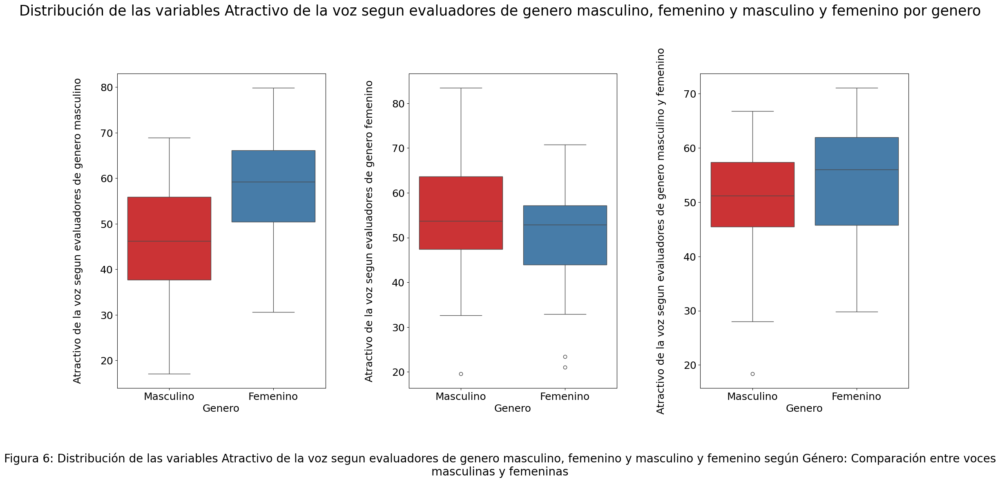

In [23]:
# Create a sample DataFrame for demonstration
data = {
    'Atractivo de la voz segun evaluadores de genero masculino': df_cleaned['attrac-voicevow-m'],
    'Atractivo de la voz segun evaluadores de genero femenino': df_cleaned['attrac-voicevow-f'],
    'Atractivo de la voz segun evaluadores de genero masculino y femenino': df_cleaned['attrac-voicevow-all'],
    'sex': df_cleaned['sex']
}
df = pd.DataFrame(data)

# Features to plot
features = ['Atractivo de la voz segun evaluadores de genero masculino', 'Atractivo de la voz segun evaluadores de genero femenino', 'Atractivo de la voz segun evaluadores de genero masculino y femenino']

# Plot the boxplots grouped by 'sex'
plot_all_boxplots_by_group_attractiveness(df=df, features=features, group_by='sex', title="Distribución de las variables Atractivo de la voz segun evaluadores de genero masculino, femenino y masculino y femenino por genero", caption="Figura 6: Distribución de las variables Atractivo de la voz segun evaluadores de genero masculino, femenino y masculino y femenino según Género: Comparación entre voces masculinas y femeninas")


### Masculinity Femininity

MASCFEM	masculinity/femininity (0=very female / 100=very male)

La variable mascfem en el dataset GEFAV es una variable continua que representa un índice de masculinidad-feminidad.

Características de la variable   según el paper:
- Escala continua: mascfem se mide en una escala continua, no en categorías discretas.
- Rango de valores: Los valores de mascfem varían en un rango específico entre 0 y 100, donde los valores más altos indican características más asociadas con la masculinidad, y los valores más bajos con la feminidad.
Origen: Esta variable se obtiene a partir de las respuestas a un cuestionario.

In [24]:
def plot_boxplot_by_group_masculinity_femininity(df, features, group_by, axes):
    for i, feature in enumerate(features):
        sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
        # axes[i].set_title(f"Distribución de {feature}", fontsize=20, wrap=True)
        axes[i].set_ylabel(feature, fontsize=18, labelpad=30, wrap=True)  # Increased padding for y-axis labels
        axes[i].set_xlabel("Genero", fontsize=18)
        axes[i].tick_params(axis='y', labelsize=18)  # Ensure y-axis tick labels are visible
        axes[i].tick_params(axis='x', labelsize=18)  # Ensure x-axis tick labels are visible
def plot_all_boxplots_by_group_masculinity_femininity(df, features, group_by, title, caption):
    fig, axes = plt.subplots(1, len(features), figsize=(25, 10), sharey=False)  # Disable shared y-axis
    
    # Plot each boxplot
    plot_boxplot_by_group(df, features, group_by, axes)
    
    # Add caption and title
    plt.figtext(0.5, -0.2, caption, ha="center", fontsize=20, wrap=True)
    fig.suptitle(title, fontsize=25, wrap=True, x=0.5, y=1.1)
    
    # Adjust layout to prevent overlap and increase spacing
    plt.tight_layout(rect=[0.01, 0.2, 1.0, 0.9])  # Leave more space for title and caption
    plt.subplots_adjust(wspace=0.4)  # Increase horizontal spacing between subplots
    
    plt.show()

#### Masculinity - Percepcion segun evaluadores masculinos



/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i],

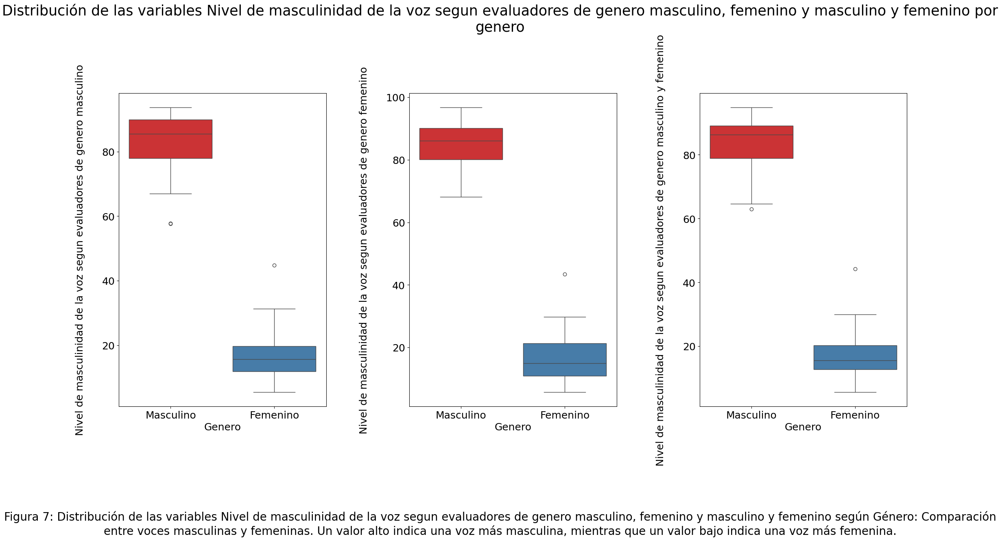

In [25]:
# Create a sample DataFrame for demonstration
data = {
    'Nivel de masculinidad de la voz segun evaluadores de genero masculino': df_cleaned['mascfem-voicevow-m'],
    'Nivel de masculinidad de la voz segun evaluadores de genero femenino': df_cleaned['mascfem-voicevow-f'],
    'Nivel de masculinidad de la voz segun evaluadores de genero masculino y femenino': df_cleaned['mascfem-voicevow-all'],
    'sex': df_cleaned['sex']
}
df = pd.DataFrame(data)

# Features to plot
features = ['Nivel de masculinidad de la voz segun evaluadores de genero masculino', 'Nivel de masculinidad de la voz segun evaluadores de genero femenino', 'Nivel de masculinidad de la voz segun evaluadores de genero masculino y femenino']

# Plot the boxplots grouped by 'sex'
plot_all_boxplots_by_group_masculinity_femininity(df=df, features=features, group_by='sex', title="Distribución de las variables Nivel de masculinidad de la voz segun evaluadores de genero masculino, femenino y masculino y femenino por genero", caption="Figura 7: Distribución de las variables Nivel de masculinidad de la voz segun evaluadores de genero masculino, femenino y masculino y femenino según Género: Comparación entre voces masculinas y femeninas. Un valor alto indica una voz más masculina, mientras que un valor bajo indica una voz más femenina.")


### Dominance
DOMIN	dominance (0=not at all dominant / 100=extremely dominant)

La variable DOMIN en el dataset GEFAV representa la dominancia de la voz. Es una variable continua que se mide en una escala de 0 a 100, donde:
0: Indica que la voz no es dominante en absoluto.
100: Indica que la voz es extremadamente dominante.

In [26]:
def plot_boxplot_by_group_dominance(df, features, group_by, axes):
    for i, feature in enumerate(features):
        sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
        # axes[i].set_title(f"Distribución de {feature}", fontsize=20, wrap=True)
        axes[i].set_ylabel(feature, fontsize=18, labelpad=30, wrap=True)  # Increased padding for y-axis labels
        axes[i].set_xlabel("Genero", fontsize=18)
        axes[i].tick_params(axis='y', labelsize=18)  # Ensure y-axis tick labels are visible
        axes[i].tick_params(axis='x', labelsize=18)  # Ensure x-axis tick labels are visible
def plot_all_boxplots_by_group_dominance(df, features, group_by, title, caption):
    fig, axes = plt.subplots(1, len(features), figsize=(25, 10), sharey=False)  # Disable shared y-axis
    
    # Plot each boxplot
    plot_boxplot_by_group(df, features, group_by, axes)
    
    # Add caption and title
    plt.figtext(0.5, -0.2, caption, ha="center", fontsize=20, wrap=True)
    fig.suptitle(title, fontsize=25, wrap=True, x=0.5, y=1.1)
    
    # Adjust layout to prevent overlap and increase spacing
    plt.tight_layout(rect=[0.01, 0.2, 1.0, 0.9])  # Leave more space for title and caption
    plt.subplots_adjust(wspace=0.4)  # Increase horizontal spacing between subplots
    
    plt.show()

/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i],

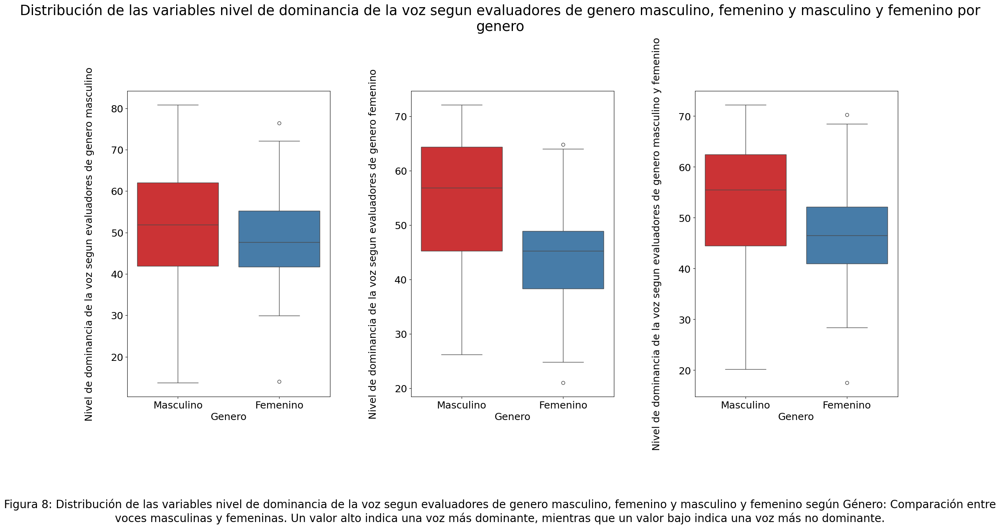

In [27]:
# Create a sample DataFrame for demonstration
data = {
    'Nivel de dominancia de la voz segun evaluadores de genero masculino': df_cleaned['domin-voicevow-m'],
    'Nivel de dominancia de la voz segun evaluadores de genero femenino': df_cleaned['domin-voicevow-f'],
    'Nivel de dominancia de la voz segun evaluadores de genero masculino y femenino': df_cleaned['domin-voicevow-all'],
    'sex': df_cleaned['sex']
}
df = pd.DataFrame(data)

# Features to plot
features = ['Nivel de dominancia de la voz segun evaluadores de genero masculino', 'Nivel de dominancia de la voz segun evaluadores de genero femenino', 'Nivel de dominancia de la voz segun evaluadores de genero masculino y femenino']

# Plot the boxplots grouped by 'sex'
plot_all_boxplots_by_group_dominance(df=df, features=features, group_by='sex', title="Distribución de las variables nivel de dominancia de la voz segun evaluadores de genero masculino, femenino y masculino y femenino por genero", caption="Figura 8: Distribución de las variables nivel de dominancia de la voz segun evaluadores de genero masculino, femenino y masculino y femenino según Género: Comparación entre voces masculinas y femeninas. Un valor alto indica una voz más dominante, mientras que un valor bajo indica una voz más no dominante.")


### Health
HEALTH	health (0=not at all healthy / 100=extremely healthy)
La variable HEALTH en el dataset GEFAV representa la salud de la voz. Es una variable continua que se mide en una escala de 0 a 100, donde:
0: Indica que la voz no es saludable en absoluto.
100: Indica que la voz es extremadamente saludable.

In [28]:
def plot_boxplot_by_group_health(df, features, group_by, axes):
    for i, feature in enumerate(features):
        sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
        # axes[i].set_title(f"Distribución de {feature}", fontsize=20, wrap=True)
        axes[i].set_ylabel(feature, fontsize=18, labelpad=30, wrap=True)  # Increased padding for y-axis labels
        axes[i].set_xlabel("Genero", fontsize=18)
        axes[i].tick_params(axis='y', labelsize=18)  # Ensure y-axis tick labels are visible
        axes[i].tick_params(axis='x', labelsize=18)  # Ensure x-axis tick labels are visible
def plot_all_boxplots_by_group_health(df, features, group_by, title, caption):
    fig, axes = plt.subplots(1, len(features), figsize=(25, 10), sharey=False)  # Disable shared y-axis
    
    # Plot each boxplot
    plot_boxplot_by_group(df, features, group_by, axes)
    
    # Add caption and title
    plt.figtext(0.5, -0.2, caption, ha="center", fontsize=20, wrap=True)
    fig.suptitle(title, fontsize=25, wrap=True, x=0.5, y=1.1)
    
    # Adjust layout to prevent overlap and increase spacing
    plt.tight_layout(rect=[0.01, 0.2, 1.0, 0.9])  # Leave more space for title and caption
    plt.subplots_adjust(wspace=0.4)  # Increase horizontal spacing between subplots
    
    plt.show()


/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i],

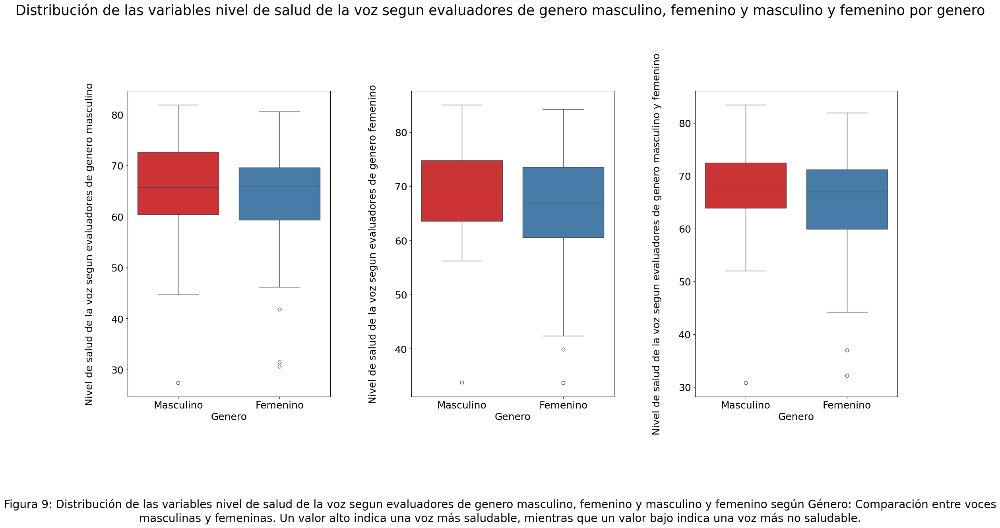

In [29]:
    
# Create a sample DataFrame for demonstration
data = {
    'Nivel de salud de la voz segun evaluadores de genero masculino': df_cleaned['health-voicevow-m'],
    'Nivel de salud de la voz segun evaluadores de genero femenino': df_cleaned['health-voicevow-f'],
    'Nivel de salud de la voz segun evaluadores de genero masculino y femenino': df_cleaned['health-voicevow-all'],
    'sex': df_cleaned['sex']
}
df = pd.DataFrame(data)

# Features to plot
features = ['Nivel de salud de la voz segun evaluadores de genero masculino', 'Nivel de salud de la voz segun evaluadores de genero femenino', 'Nivel de salud de la voz segun evaluadores de genero masculino y femenino']

# Plot the boxplots grouped by 'sex'
plot_all_boxplots_by_group_health(df=df, features=features, group_by='sex', title="Distribución de las variables nivel de salud de la voz segun evaluadores de genero masculino, femenino y masculino y femenino por genero", caption="Figura 9: Distribución de las variables nivel de salud de la voz segun evaluadores de genero masculino, femenino y masculino y femenino según Género: Comparación entre voces masculinas y femeninas. Un valor alto indica una voz más saludable, mientras que un valor bajo indica una voz más no saludable.")

### Trust
TRUST	trust (0=not at all trustworthy / 100=extremely trustworthy)
La variable TRUST en el dataset GEFAV representa la confianza de la voz. Es una variable continua que se mide en una escala de 0 a 100, donde:
0: Indica que la voz no es confiable en absoluto.
100: Indica que la voz es extremadamente confiable.

In [30]:
def plot_boxplot_by_group_trust(df, features, group_by, axes):
    for i, feature in enumerate(features):
        sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
        # axes[i].set_title(f"Distribución de {feature}", fontsize=20, wrap=True)
        axes[i].set_ylabel(feature, fontsize=18, labelpad=30, wrap=True)  # Increased padding for y-axis labels
        axes[i].set_xlabel("Genero", fontsize=18)
        axes[i].tick_params(axis='y', labelsize=18)  # Ensure y-axis tick labels are visible
        axes[i].tick_params(axis='x', labelsize=18)  # Ensure x-axis tick labels are visible
def plot_all_boxplots_by_group_trust(df, features, group_by, title, caption):
    fig, axes = plt.subplots(1, len(features), figsize=(25, 10), sharey=False)  # Disable shared y-axis
    
    # Plot each boxplot
    plot_boxplot_by_group(df, features, group_by, axes)
    
    # Add caption and title
    plt.figtext(0.5, -0.2, caption, ha="center", fontsize=20, wrap=True)
    fig.suptitle(title, fontsize=25, wrap=True, x=0.5, y=1.1)
    
    # Adjust layout to prevent overlap and increase spacing
    plt.tight_layout(rect=[0.01, 0.2, 1.0, 0.9])  # Leave more space for title and caption
    plt.subplots_adjust(wspace=0.4)  # Increase horizontal spacing between subplots
    
    plt.show()

/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i], palette="Set1")
/var/folders/sf/260b6v5x31x4l659jpkpl6dm0000gn/T/ipykernel_73406/2262737984.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=group_by, y=feature, data=df, ax=axes[i],

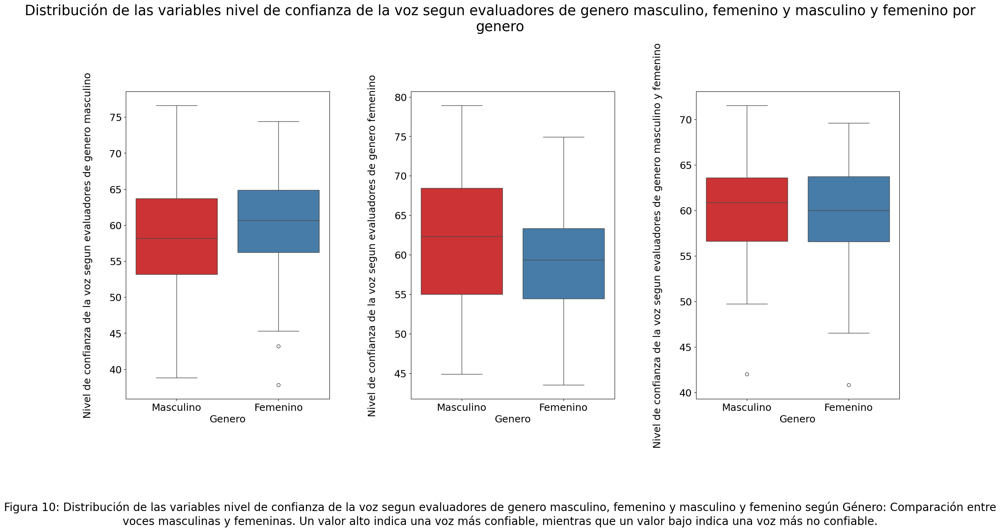

In [31]:
# Create a sample DataFrame for demonstration
data = {
    'Nivel de confianza de la voz segun evaluadores de genero masculino': df_cleaned['trust-voicevow-m'],
    'Nivel de confianza de la voz segun evaluadores de genero femenino': df_cleaned['trust-voicevow-f'],
    'Nivel de confianza de la voz segun evaluadores de genero masculino y femenino': df_cleaned['trust-voicevow-all'],
    'sex': df_cleaned['sex']
}
df = pd.DataFrame(data)

# Features to plot
features = ['Nivel de confianza de la voz segun evaluadores de genero masculino', 'Nivel de confianza de la voz segun evaluadores de genero femenino', 'Nivel de confianza de la voz segun evaluadores de genero masculino y femenino']

# Plot the boxplots grouped by 'sex'
plot_all_boxplots_by_group_trust(df=df, features=features, group_by='sex', title="Distribución de las variables nivel de confianza de la voz segun evaluadores de genero masculino, femenino y masculino y femenino por genero", caption="Figura 10: Distribución de las variables nivel de confianza de la voz segun evaluadores de genero masculino, femenino y masculino y femenino según Género: Comparación entre voces masculinas y femeninas. Un valor alto indica una voz más confiable, mientras que un valor bajo indica una voz más no confiable.")

# Analisis Multivariado

In [62]:
#create categorical variables for age so it gets cattegories from 15-19, 20-24, 25-29, 30-34, 35-39
df_cleaned['age_category'] = pd.cut(df_cleaned['age'], bins=[15, 19, 24, 29, 34, 39], labels=['15-19', '20-24', '25-29', '30-34', '35-39'])

# Convert sex to numeric
df_cleaned['sex'] = df_cleaned['sex'].map({'M': 0.0, 'F': 1.0})

# covert age_category to numeric
df_cleaned['age_category'] = df_cleaned['age_category'].map({'15-19': 0.0, '20-24': 1.0, '25-29': 2.0, '30-34': 3.0, '35-39': 4.0})


### Scatter Plot Matrix

In [63]:
ignore_vars = ["file", "label", "sample_name"]
voicesent_vars = [
    var
    for var in list(df_cleaned.columns)
    if "voicesent-f" in var or "voicesent-m" in var
]
voicesent_all_vars = [var for var in list(df_cleaned.columns) if "voicesent-all" in var]

voicevow_vars = [
    var
    for var in list(df_cleaned.columns)
    if "voicevow-f" in var or "voicevow-m" in var
]
voicevow_all_vars = [var for var in list(df_cleaned.columns) if "voicevow-all" in var]

other_vars = [
    var
    for var in list(df_cleaned.columns)
    if var not in voicesent_vars
    and var not in voicevow_vars
    and var not in ignore_vars
    and var not in voicevow_all_vars
    and var not in voicesent_all_vars
]

In [64]:
other_vars

['f0_mean',
 'f1_mean',
 'f2_mean',
 'f3_mean',
 'intensity_mean',
 'jitter_local',
 'shimmer_local',
 'f0_median',
 'f0_std',
 'age',
 'sex',
 'age_category']

In [65]:
voicevow_vars

['attrac-voicevow-f',
 'attrac-voicevow-m',
 'mascfem-voicevow-f',
 'mascfem-voicevow-m',
 'domin-voicevow-f',
 'domin-voicevow-m',
 'health-voicevow-f',
 'health-voicevow-m',
 'trust-voicevow-f',
 'trust-voicevow-m']

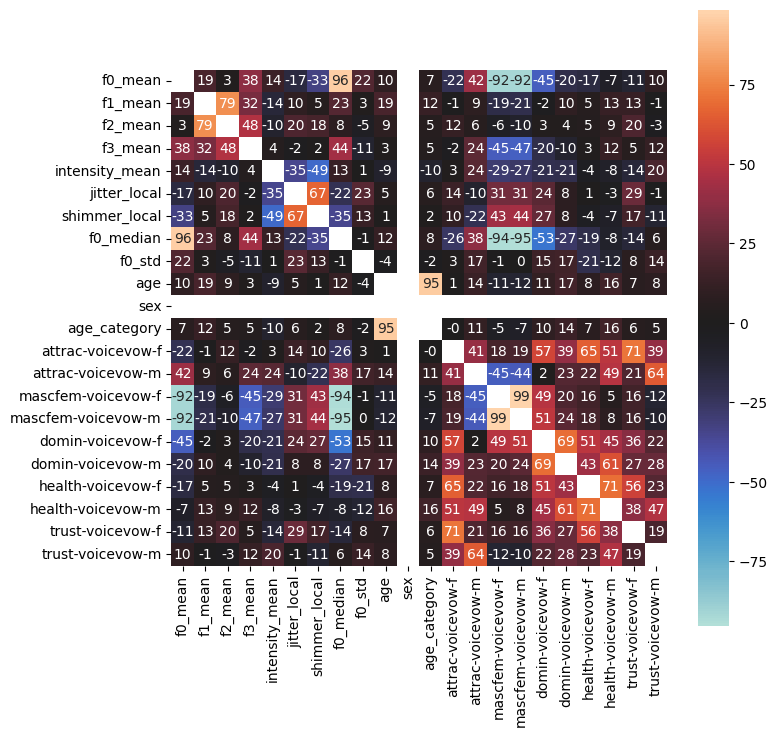

In [66]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'df' is your DataFrame
# Select only numeric columns for correlation calculation
numeric_df = df_cleaned[other_vars + voicevow_vars]

plt.figure(figsize=(8, 8))
df_corr = numeric_df.corr() * 100
sns.heatmap(df_corr, square=True, annot=True, fmt=".0f", mask=np.eye(len(df_corr)), center=0)
plt.show()

#### Scatter Plot Matrix para las variables de percepcion de la voz en oraciones 

In [38]:
def plot_scatter_matrix(df, hue_column, save_path=None):
    import matplotlib.pyplot as plt
    import seaborn as sns

    g = sns.pairplot(df, hue=hue_column, palette="Set1")

    for ax in g.axes.flat:
        ax.tick_params(axis="both", labelleft=True, labelbottom=True)

    plt.subplots_adjust(wspace=0.7, hspace=0.3)

    xlabels, ylabels = [], []

    for ax in g.axes[-1, :]:
        xlabel = ax.xaxis.get_label_text()
        xlabels.append(xlabel)
    for ax in g.axes[:, 0]:
        ylabel = ax.yaxis.get_label_text()
        ylabels.append(ylabel)

    for i in range(len(xlabels)):
        for j in range(len(ylabels)):
            g.axes[j, i].xaxis.set_label_text(xlabels[i], visible=True)
            g.axes[j, i].yaxis.set_label_text(ylabels[j], visible=True)

    plt.tight_layout()

    # Save the figure
    if save_path:
        plt.savefig(save_path)
    plt.show()

In [46]:
df_cleaned[voicesent_vars + other_vars].columns

Index(['attrac-voicesent-f', 'attrac-voicesent-m', 'mascfem-voicesent-f',
       'mascfem-voicesent-m', 'domin-voicesent-f', 'domin-voicesent-m',
       'health-voicesent-f', 'health-voicesent-m', 'trust-voicesent-f',
       'trust-voicesent-m', 'f0_mean', 'f1_mean', 'f2_mean', 'f3_mean',
       'intensity_mean', 'jitter_local', 'shimmer_local', 'f0_median',
       'f0_std', 'sample_name', 'age', 'sex', 'age_category'],
      dtype='object')

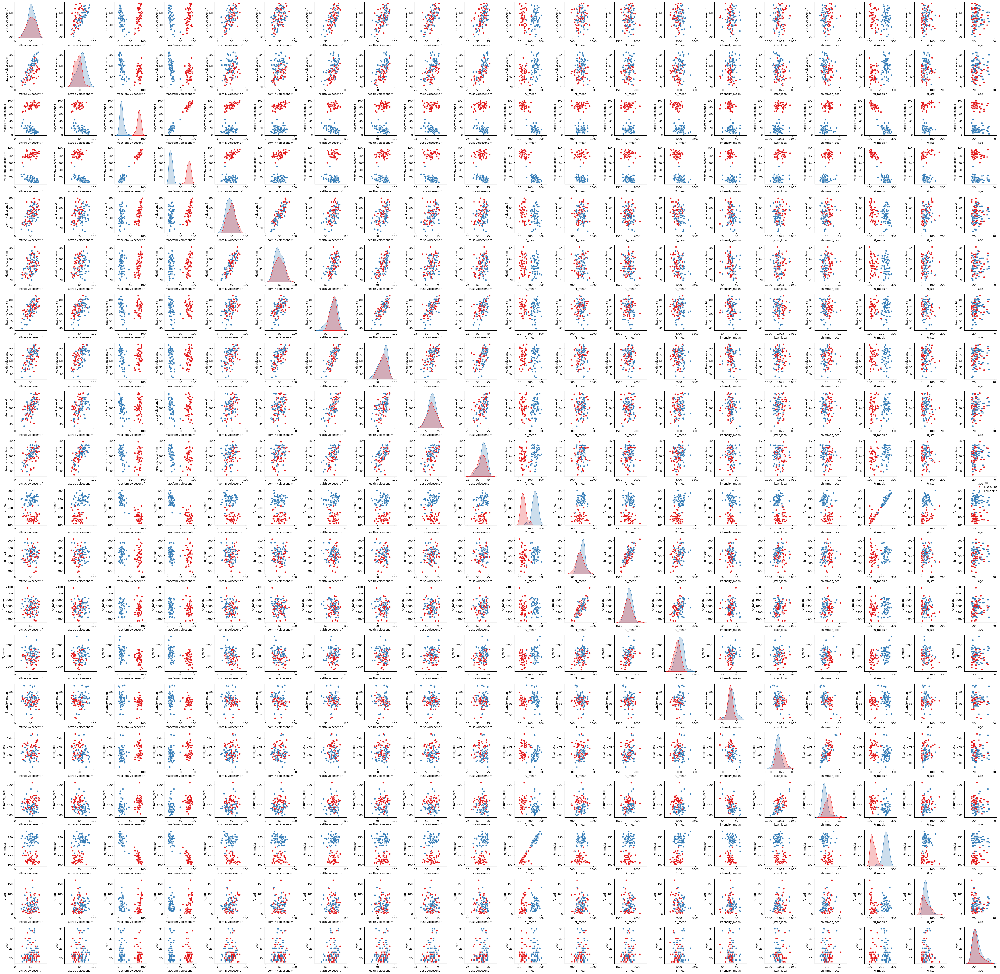

In [39]:
plot_scatter_matrix(df_cleaned[voicesent_vars + other_vars], hue_column="sex")

#### Scatter Plot Matrix para las variables de percepcion de la voz en vocales

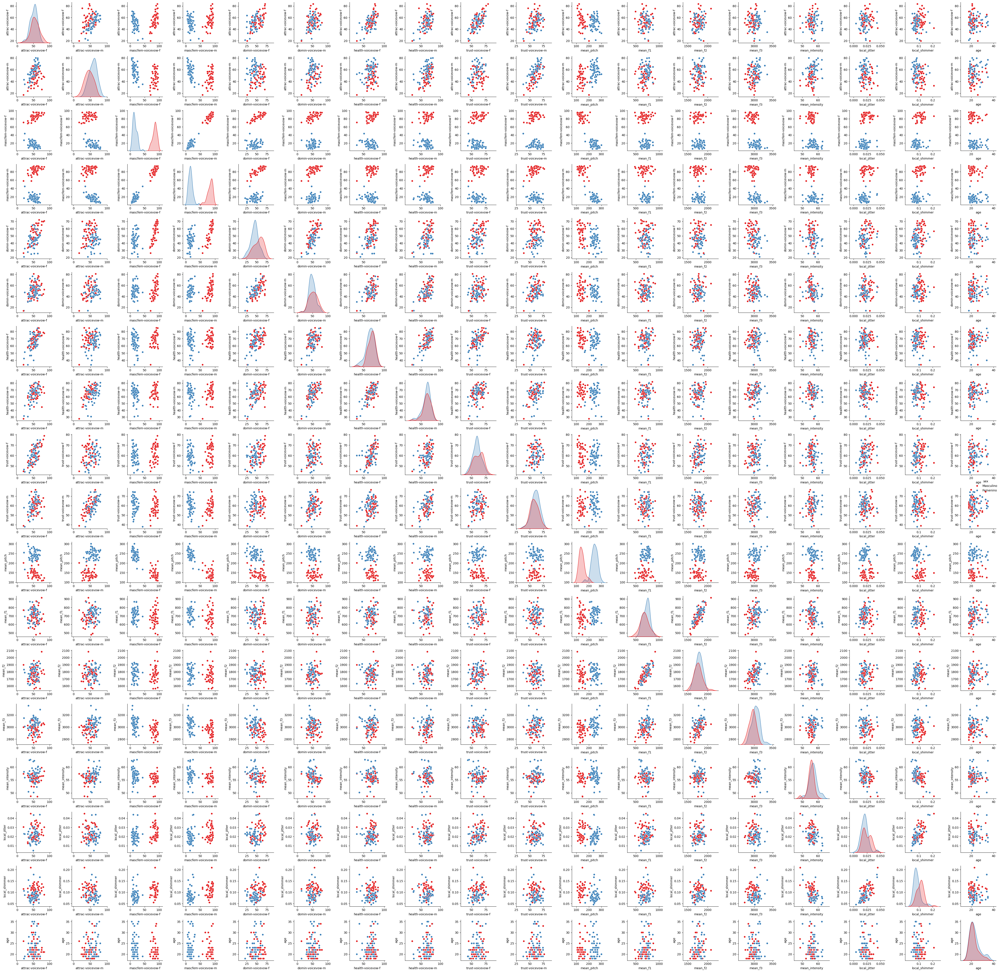

In [157]:
plot_scatter_matrix(df_cleaned[voicevow_vars + other_vars], hue_column="sex")

#### Scatter Plot Matrix para las variables de percepcion de la voz en oraciones para los estimulos de ambos generos

In [158]:
[voicesent_vars + other_vars]

[['attrac-voicesent-f',
  'attrac-voicesent-m',
  'mascfem-voicesent-f',
  'mascfem-voicesent-m',
  'domin-voicesent-f',
  'domin-voicesent-m',
  'health-voicesent-f',
  'health-voicesent-m',
  'trust-voicesent-f',
  'trust-voicesent-m',
  'mean_pitch',
  'mean_f1',
  'mean_f2',
  'mean_f3',
  'mean_intensity',
  'local_jitter',
  'local_shimmer',
  'sample_name',
  'age',
  'sex']]

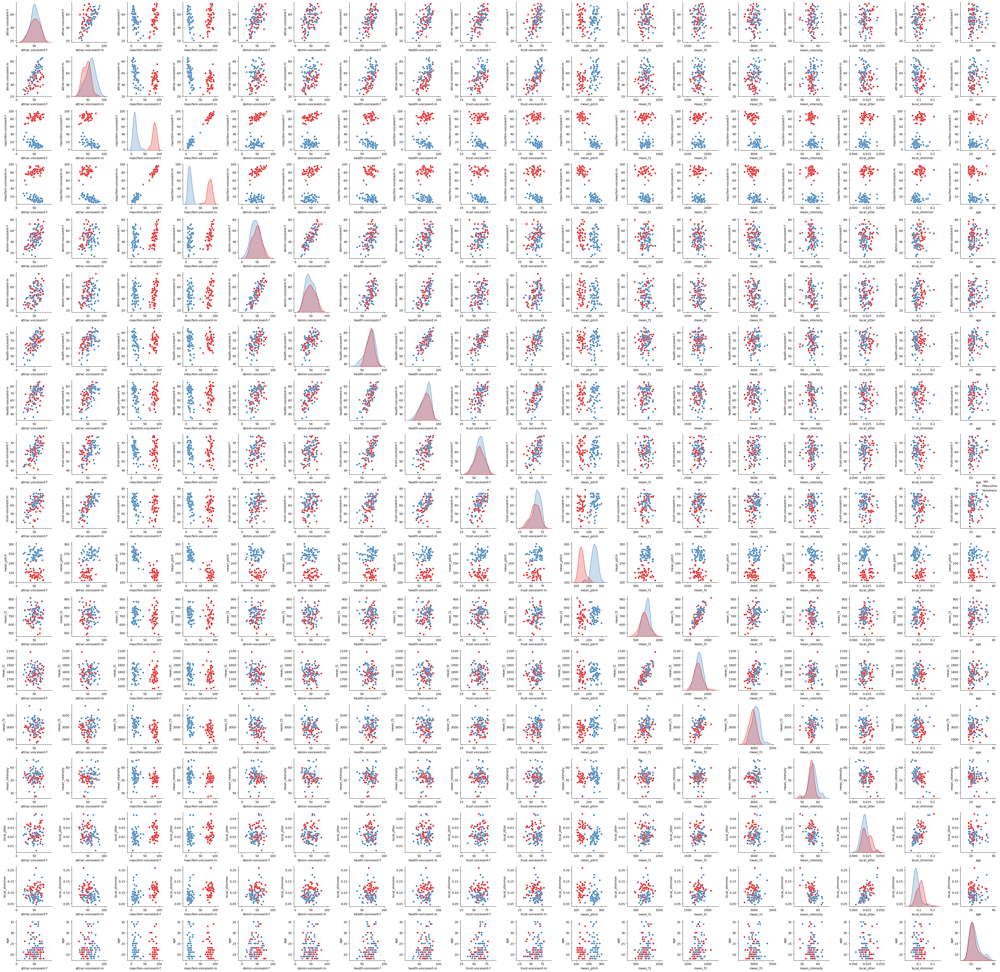

In [159]:
plot_scatter_matrix(df_cleaned[voicesent_vars + other_vars], hue_column="sex")

### Correlacion entre Variables

In [42]:
# Filter the DataFrame to keep only numeric columns
numeric_df = df.select_dtypes(include=["float64", "int64"])

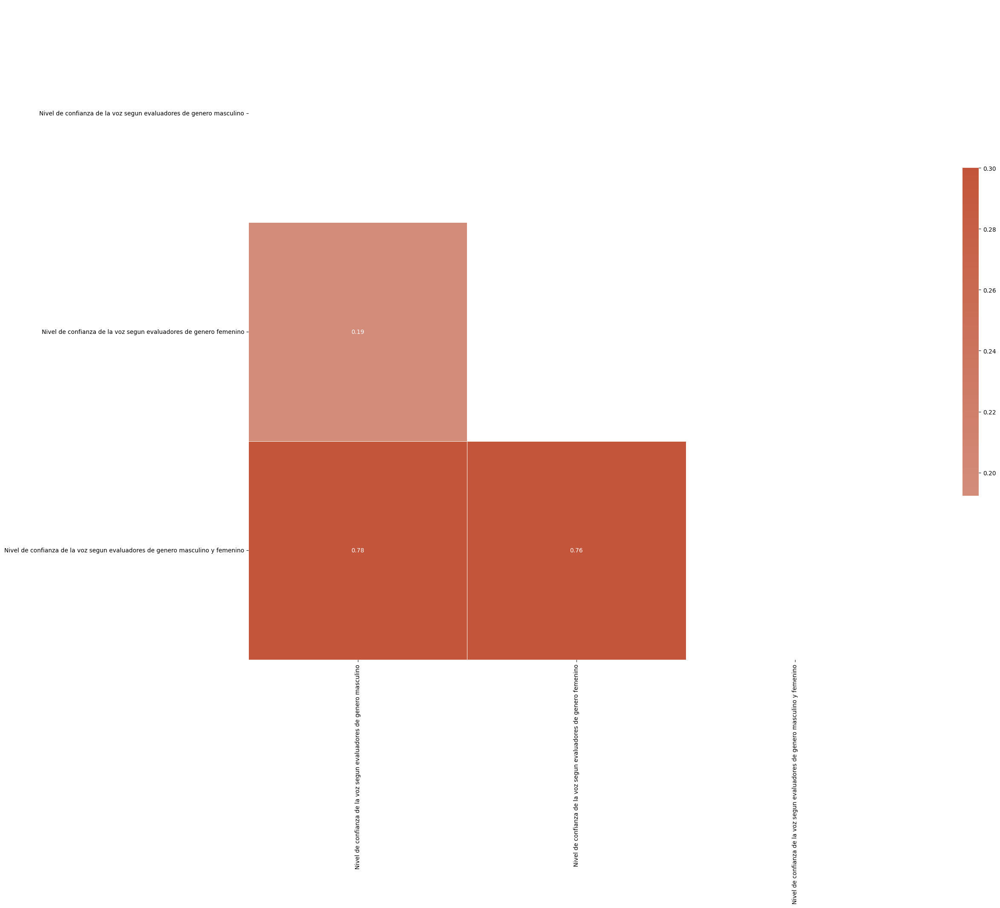

In [43]:
# Let's say `df` is your pandas DataFrame. Compute correlation matrix
corr = numeric_df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(35, 20))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(
    corr,
    mask=mask,
    cmap=cmap,
    vmax=0.3,
    center=0,
    annot=True,
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
)

plt.show()

### Altas Correlaciones
- Las variables relacionadas con las percepciones de atractivo, masculinidad/feminidad, dominancia, salud y confianza muestran altas correlaciones entre sus diferentes dimensiones (sent y vow, y entre f, m, y all). Esto sugiere que las percepciones en un contexto (sentencias o vocales) y para un género específico están fuertemente relacionadas con las percepciones en otros contextos y géneros. (REVISAR)

### Bajas Correlaciones
- Las medidas acústicas (mean_pitch, mean_f1, mean_f2, mean_f3, mean_intensity, local_jitter, local_shimmer) no parecen estar fuertemente correlacionadas con las evaluaciones subjetivas (attrac-*, mascfem-*, domin-*, health-*, trust-*). Esto sugiere que las características acústicas no explican directamente las percepciones subjetivas de la voz en los datos proporcionados.

### Correlaciones Entre Características Acústicas
- Medidas de Formantes: Las correlaciones entre mean_f1, mean_f2, y mean_f3 son relativamente altas, lo cual es esperado, ya que los formantes están relacionados y tienden a variar conjuntamente en función de las características fisiológicas y articulatorias del hablante.

- Medidas de Estabilidad: local_jitter y local_shimmer no muestran una fuerte correlación entre sí ni con las otras características acústicas.

### Correlación con Edad
- Edad: La variable age no parece estar fuertemente correlacionada con las otras variables, lo cual puede indicar que la edad no es un factor determinante en las medidas acústicas ni en las evaluaciones subjetivas de la voz en este conjunto de datos.

## Conclusiones Específicas
- Relaciones Intrínsecas: Las evaluaciones subjetivas de la voz están altamente correlacionadas entre sí, lo cual indica que las percepciones de atractivo, masculinidad/feminidad, dominancia, salud y confianza tienden a estar alineadas. Un alto valor en una dimensión tiende a estar asociado con altos valores en las otras dimensiones.
- Medidas Acústicas y Percepciones Subjetivas: La falta de correlación significativa entre las medidas acústicas y las evaluaciones subjetivas sugiere que otros factores, posiblemente contextuales o perceptuales, influyen más en las evaluaciones subjetivas de la voz que las características acústicas puras.
- Dimensiones Acústicas Relacionadas: Las medidas de los formantes (mean_f1, mean_f2, mean_f3) están correlacionadas, lo cual es coherente con el conocimiento existente sobre la producción del habla.
